# Combine PS1 DR2 r and SDSS r  : NEW 190807


Based on `Combine_PS1_SDSS_clean.ipynb`, which comes from `Combine_all_to_SDSS_r.ipynb` , which in turn derives from `AC_combined_LC...`.  

The main change is the cleaning procedure  - I found out that the main issue is the sigma -clipping in the magnitude space, which removed big chunks of SDSS light curves. This was unacceptable, so I'm quickly redoing the combination of SDSS-PS1. 

Given that it's only the update, the initial combination of raw SDSS QSO from and PS1 DR2 was fine - the light curves stored in `rawDir = '../dp2/real_sdss_ps1r_dr2/'` are the starting point of the cleaning. 

To **recap**, light curves in `real_sdss_ps1r_dr2`  are the PS1 DR2 detections   `S82_DR7_QSO_PS1_det_suberlak.csv` and ids corresponding to each dbID `S82_DR7_QSO_PS1_objID_suberlak.csv`.

I removed negative and 0 fluxes, calculated AB magnitudes , chose only r-band.

Then aggregating over dbID,  I took each PS1 DR2 light curve, and added the r-band data for the SDSS light curve from `../../CRTS_PROJECT/raw_LC_SDSS/QSO_S82/`.

For the SDSS data I only removed those epochs which did not have obs in that band (mag=0). 

They were stacked, with structure `mag, magerr , mjd, survey` , without any offsets, because SDSS r is very close to PS1 r (see `SDSS_PS1_DR2_stellar_offsets.ipynb`) 

**Now**, the cleaning : 

   * read in the SDSS-PS1 DR2 r-band raw light curve from `real_sdss_ps1r_dr2`
   
   * remove points that have error > 1 mag  (bad)
   * remove points that have mag > 30 (bad)
   * remove points before MJD=50000 (bad  - that's long before the beginning of the SDSS)
   * calculate median(SDSS-PS1 error), and sigmaG(error) - find points further than 7 stdev from the median . Remove, but keep a copy in `removed_data` dic [lcname, mjd, mag, magerr ] 
   
   * calculate median(SDSS-PS1 mag), and sigmaG(SDSS-PS1 mag)  - if there are any points that depart by more than 7stdev,  flag them 'flare' , and add to `possible_flares` dic [lcname , mjd, mag, magerr, ( mag -median ) / sigmaG. Don't remove yet. 
   
   * in day-averaging, ignore the points flagged as '10stdev' 





In [1]:
import numpy as np
import matplotlib.pyplot as plt 
import os
import pandas as pd 
from astropy.table import Table
from astropy.coordinates import SkyCoord
from astropy import units as u
from astropy.table import  hstack
from astropy.table import  vstack
from astropy.table import Column
from astropy.table import join
from astropy.table import unique
from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18


In [2]:
rawDir = '../dp2/real_sdss_ps1r_dr2/'
intDir = '../dp2/real_sdss_ps1r_dr2_cleaning_NEW/'
finalDir = '../dp2/real_sdss_ps1r_dr2_cleaned_NEW/'

lcnames = os.listdir(rawDir)

removed_data = {}
possible_flares = {}

for i in range(len(lcnames)):
    lcname = lcnames[i]
    lc = Table.read(rawDir+lcname, format='ascii',)

    # remove points that have error > 1 mag  (bad)
    lc.remove_rows(lc['magerr']>1)
    
    # remove points that have mag > 30 (bad)
    lc.remove_rows(lc['mag']>30)

    # remove points before MJD=50000 (bad) 
    lc.remove_rows(lc['mjd']<50000)
    
    # first flag 7sigma error outliers, then remove 
    Nsig = 7
    sigmaGerr =  0.7413 * (np.percentile(lc['magerr'],75) -\
                         np.percentile(lc['magerr'],25))
    Nstdev = np.abs(np.ma.median(lc['magerr']) -  lc['magerr']) / sigmaGerr
    merr = Nstdev  > Nsig
    
    if np.sum(merr) > 0: 
        # then first add to the dictionary 
        removed_data[lcname] = lc[merr]
        
        # then remove 
        lc.remove_rows(merr)
        
    # flag the 7sigma mag outliers, need to inspect 
    Nsig = 7
    sigmaGmag =  0.7413 * (np.percentile(lc['mag'],75) -\
                        np.percentile(lc['mag'],25))
    Nstdev = np.abs(np.ma.median(lc['mag']) - lc['mag'])/sigmaGmag
    msig =  Nstdev > Nsig
    # store the information as a flag 
    lc['flare'] = 0
    lc['flare'][msig] = 1 
    
    if np.sum(msig) > 0: 
        # then first add to the dictionary 
        possible_flares[lcname] = lc[msig]
        
    # do day averaging, but ignore points marked as possible flares ...
    lc['mjdint'] = lc['mjd'].astype(int)
    lc['Nobs']  = 1
    lc['medmag'] = lc['mag']
    lc['avgmag'] = lc['mag'] # same with avgmag ...  
    lc['avgerr'] = lc['magerr'] # same with err  ...  
    
    
    # find out which days have more than 1 obs 
    good = lc['flare'] == 0 # avoid the possible flares 
    value, count = np.unique(lc['mjdint'][good], return_counts=True)

    # for those that do, update the value of Nobs, 
    # and populate the medmag with the median of these days 
    for mjd in value[count > 1] : 
        rows = lc['mjdint'] == mjd
        lc['Nobs'][rows] = count[value == mjd]
        lc['medmag'][rows] = np.ma.median(lc['mag'][rows])
        
        weights = 1.0 / (lc['magerr'][rows] * lc['magerr'][rows])
        average = np.sum(weights * lc['mag'][rows]) / np.sum(weights)

        lc['avgmag'][rows] = average
        avgerr  = 1.0 / (np.sqrt(np.sum(weights)))
        # if error < 0.02 , we add 0.01 in quadrature ... 
        if avgerr < 0.02 : 
            avgerr  = np.sqrt(avgerr**2 + 0.01**2)
        lc['avgerr'][rows] = avgerr
        
        
    # store the intermediate data product 
    lc.write(intDir+lcname, format='ascii', overwrite='True')

    # finally, keep only one of the day-averaged products
    lc_unique = unique(lc[good], keys='mjdint')
    
    # keep the flares for now ... 
    lc1 = vstack([lc_unique, lc[~good]])
    # make a copy keeping only avgmag, avgerr, 
    # renaming them as mag, magerr ... 
    
    # also, keep Nobs, so we know which points come from day-averaging,
    # and which are not 
    lc2 = lc1[['mjd', 'avgmag', 'avgerr','survey', 'flare', 'Nobs']].copy()
    lc2.rename_column('avgmag', 'mag')
    lc2.rename_column('avgerr', 'magerr')

    # Save the light curve : SDSS r and PS1 r, no offsets ,
    # removed 6 sigma outliers in error  space , 
    # flagged 7 sigma outliers in mag space for inspection,
    # for Nobs> 1 (excluding possible flares) 
    # calculated daily  mean weighted by errors,
    # and combined errors, as in Eq.3,4 of Suberlak_2018
    lc2.write(finalDir+lcname, format='ascii', overwrite='True')
    i += 1 
    
    if i % 1000 == 0 : 
        print(i )
        np.save('SDSS-PS1_DR2_190807_removed_data_dic', removed_data)
        np.save('SDSS-PS1_DR2_190807_flares_dic', possible_flares)

1000
2000
3000
4000
5000
6000
7000
8000


Then, inspect the flagged light curves .... 

In [78]:
fl = np.load('SDSS-PS1_DR2_190807_flares_dic.npy').item()
rem = np.load('SDSS-PS1_DR2_190807_removed_data_dic.npy').item()
print(len(fl.keys()))
lcnames = list(fl.keys())

585


100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120


/Users/chris/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370


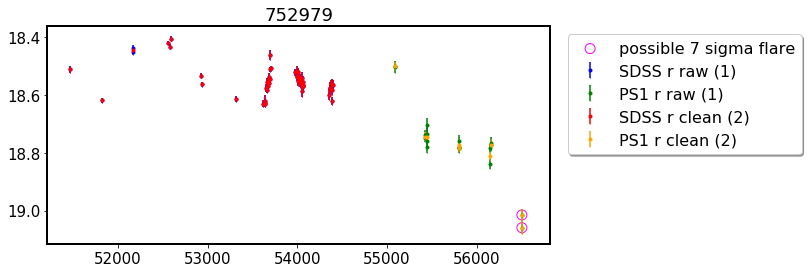

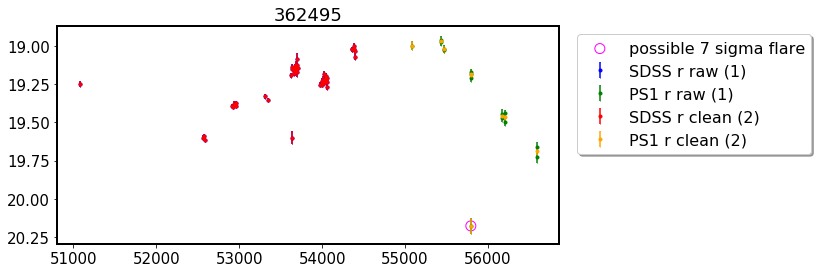

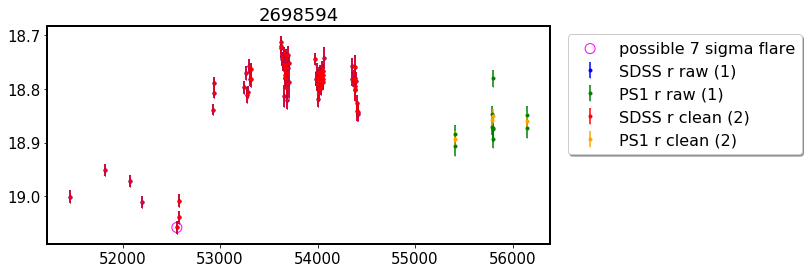

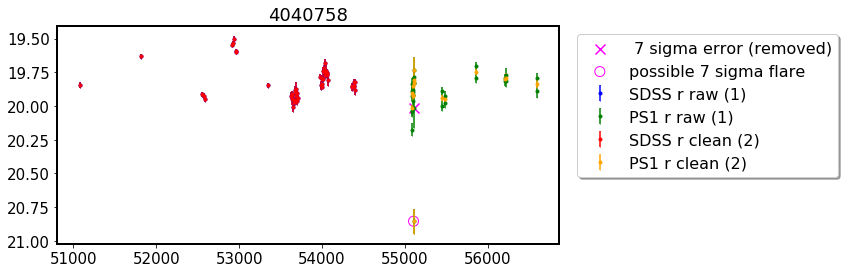

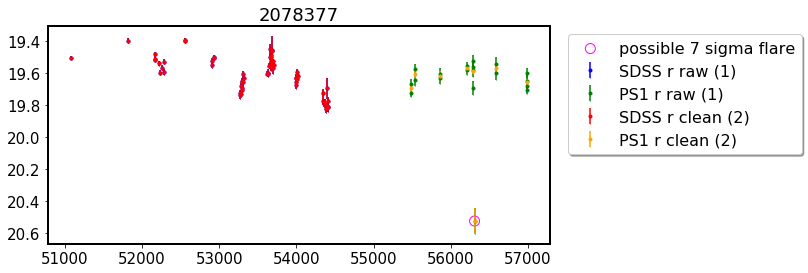

...

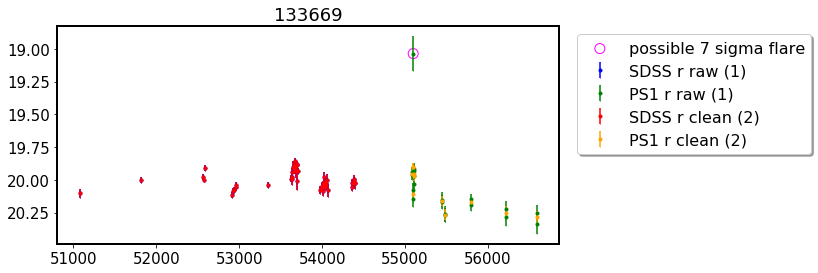

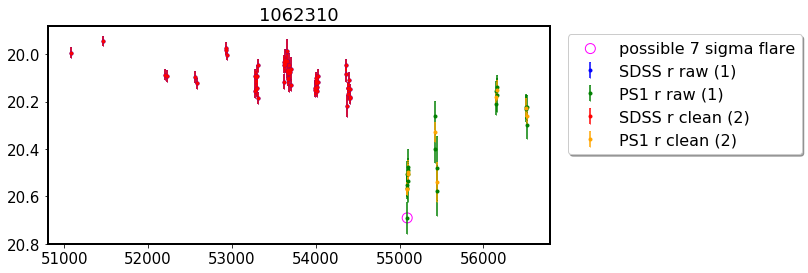

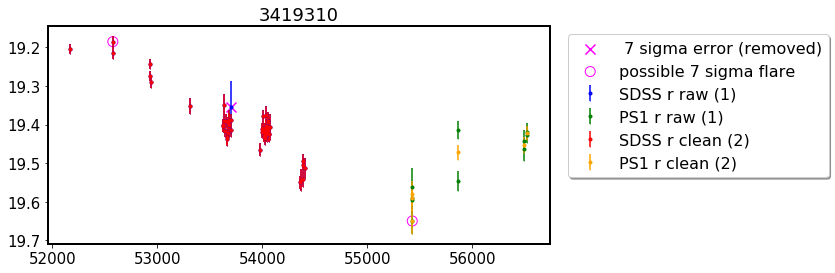

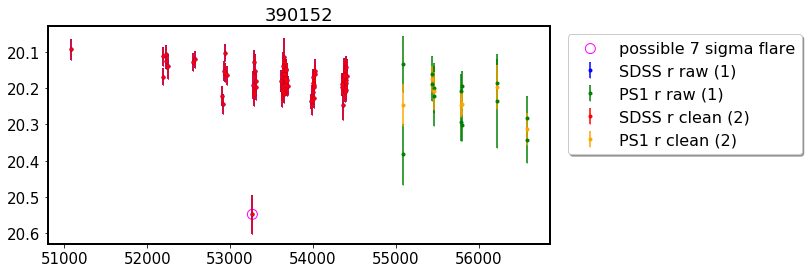

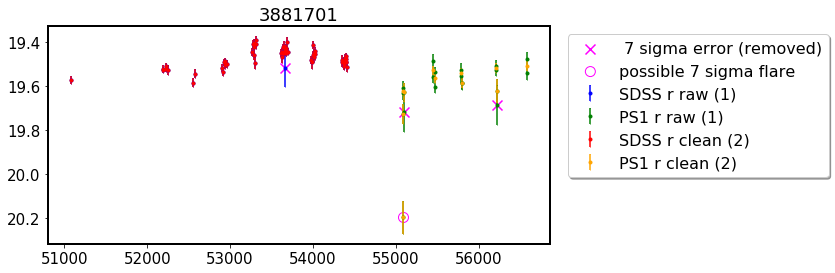

In [94]:
# Plot some light curves ... 
%matplotlib inline

for i in range(100,len(lcnames)):
    print(i)
    lcname = lcnames[i]

    fig,ax = plt.subplots(1,1,figsize=(9,4))

    # plot the signal before cleaning (SDSS&PS1)
    lc = Table.read(rawDir+lcname, format='ascii')
    rows = lc['survey'] =='sdss'
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                        fmt=".", capsize=0.2, label='SDSS r raw (1)',
                        c ='blue', )
    rows = lc['survey'] == 'ps1'
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                    fmt=".", capsize=0.2, label='PS1 r raw (1)',
                    c ='green')

    
    # plot what's deleted as error outlier 
    if lcname in rem.keys():
        ax.scatter(rem[lcname]['mjd'],rem[lcname]['mag'], marker='x',
                    s=100, facecolors='magenta', 
                   label=' 7 sigma error (removed)',
                    )

    # plot what's marked as mag flare 
    #lc = Table.read(intDir+lcname, format='ascii')
    #rows = lc['flare'] >0
    #print(np.sum(lc['flare']>0))
    
    ax.scatter(fl[lcname]['mjd'], fl[lcname]['mag'], s=100, 
               edgecolors='magenta', facecolor='none', label='possible 7 sigma flare',
                )
    

    # after cleaning:  
    lc = Table.read(finalDir+lcname, format='ascii')    

    # plot what's marked as err outlier for SDSS
    rows = (lc['survey'] == 'sdss')
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                    fmt=".", capsize=0.2, label='SDSS r clean (2)',
                    c ='red')
    
    # plot the clean PS1 
    rows = lc['survey'] == 'ps1'
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                        fmt=".", capsize=0.2, label='PS1 r clean (2)',
                        c ='orange')
    
    ax.legend(fontsize=16,loc='upper left', bbox_to_anchor=(1.02,1),
            ncol=1, fancybox=True, shadow=True, )
    ax.invert_yaxis()
    ax.set_title(lcname[:-4])
    plt.savefig('SDSS_PS1_DR2_190807_cleaning_'+lcname[:-4]+'.png', 
               bbox_inches='tight')
    #plt.clf()
    #plt.clf()

Then , remove the flares only if they look legitimately like flares - make a dic 'real_flares' to remove the circled points for these LCs.... Otherwise all LCs will be kept as done. 

In [102]:
really_remove = [142916, 1194125, 118629, 498584, 3297574, 672640, 
                 274603, 1266531, 2223717, 3688270, 424910, 
                 295198, 1384953, 399946, 3677716,
                 152872, 182851, 4085754, 259790, 
                 1693438, 698065,292977, 2179711, 
                 4905712, 4141511, 3405671, 73403, 201924, 1139923, 4151460, 
                 263596, 390152, 3881701, 36457, 3926101, 699064, 2520398, 4143785, 3505027, 1928345, 
                 247841, 903145, 142773, 514067, 1364210, 1517853, 1820479, 
                 1105252, 3896429, 1308057,1858925, 
                 3985483, 482825, 899132, 328467, 3741594, 1414426, 78713, 
                 3972590,353348, 3900099, 3899492, 828114, 165681, 914148, 
                 101129, 1136070, 80641, 1853135, 1660132, 4046216, 
                 164163, 4056004, 155630, 1239892, 1035792, 3760164, 
                 512363, 3263856, 4056602, 3897649, 190417, 331507,  4084763, 
                 978266, 234686, 3980496, 279962, 223661, 3329388, 
                 704808, 3505405, 1138685, 46357, 276258, 2248106, 669830, 
                 1695173,3792717, 3809728, 674281, 3591661, 1287421, 3550940, 
                 3993366, 3635145, 3742911, 1362530, 2608700, 172708, 1669526, 
                 513289, 2038260, 991401, 4026307, 292959, 3953640, 1927021, 268413, 
                 2055216,  1190383, 322283, 1715717, 211098, 4991175, 
                 1539912, 3793684, 1542379, 1574185, 1467853, 1201231, 
                 1866281, 1060677, 3962852,  3521306, 1940087, 144426, 680617, 
                 169517, 213820, 119185, 4903844, 1998276, 
                 1124730, 3788761, 1729107, 1538065, 590344, 2526521, 1219027, 
                 249495, 1841887, 1460581, 621482, 42444, 3152963, 1087933, 
                 2013394, 2212556, 1206700, 892734, 1444224, 833515, 
                 1519121, 3140394, 4128528, 1685818, 380279, 
                 2591352, 945934, 3973305, 249076, 492401, 3879601, 
                 3495234, 2263003, 656015, 1718855, 3937426, 
                 271311, 970191, 2038532,  184691, 3069468, 
                 937769, 319057, 847048, 958168, 3840132, 
                 80524, 2052028, 2565881, 3958668, 2116723, 
                 816501, 848441, 100286, 1628265, 
                 2505637, 1194845, 3794308, 1672751, 
                 3899751, 75080, 1521164, 2060885, 
                 50598, 3086740, 66572, 3979303, 
                 2533555, 3985033, 4116243, 169594, 
                 3402076, 3987620, 221975, 1307128, 
                 3081017, 1062250, 1006927, 
                 2049553, 264390,  528302, 326969, 
                 3751695, 607577, 3108961, 3994311, 203900, 
                 362495, 4040758, 2078377, 2630975, 
                 3441951, 1987463, 957362, 14323, 
                 1275231, 761418, 383194, 1353865, 700730, 
                 2560024, 3887094, 3035, 696154, 665778, 
                 1001793, 644952, 423742,
                ]

really_remove_only_ps1 = [3448378, 197071, 733054,]

np.savetxt('SDSS_PS1_DR2_190807_really_remove_list.txt', really_remove)
np.savetxt('SDSS_PS1_DR2_190807_really_remove_ps1_list.txt', really_remove_only_ps1)
# the 'SDSS_PS1_DR2_190807_cleaning_'+lcname[:-4]+'.png'  
# will keep the record of what I decided 'by eye' to actually 
# remove...

# all other LCs are as shown, 
# so the red and (SDSS), and orange (PS1) are in the cleaned LCs,
# even if flagged with magenta circle as having possible flare
# dues to being a 7 sigma mag outlier 

# so this list contains red or orange points (not yet removed), 
# but circled with magenta  - I go through these LCs again to 
# say 'yes, please remove those circled points because these
# are real flares ' 




In [11]:

really_remove

array([ 142916, 1194125,  118629,  498584, 3297574,  672640,  274603,
       1266531, 2223717, 3688270,  424910,  295198, 1384953,  399946,
       3677716,  152872,  182851, 4085754,  259790, 1693438,  698065,
        292977, 2179711, 4905712, 4141511, 3405671,   73403,  201924,
       1139923, 4151460,  263596,  390152, 3881701,   36457, 3926101,
        699064, 2520398, 4143785, 3505027, 1928345,  247841,  903145,
        142773,  514067, 1364210, 1517853, 1820479, 1105252, 3896429,
       1308057, 1858925, 3985483,  482825,  899132,  328467, 3741594,
       1414426,   78713, 3972590,  353348, 3900099, 3899492,  828114,
        165681,  914148,  101129, 1136070,   80641, 1853135, 1660132,
       4046216,  164163, 4056004,  155630, 1239892, 1035792, 3760164,
        512363, 3263856, 4056602, 3897649,  190417,  331507, 4084763,
        978266,  234686, 3980496,  279962,  223661, 3329388,  704808,
       3505405, 1138685,   46357,  276258, 2248106,  669830, 1695173,
       3792717, 3809

In [12]:
#Code to open finalDir  LCs,  and remove the flagged points from the final LCs...

really_remove = np.genfromtxt('SDSS_PS1_DR2_190807_really_remove_list.txt',).astype(int)
really_remove_only_ps1 = np.genfromtxt('SDSS_PS1_DR2_190807_really_remove_ps1_list.txt').astype(int)

# remove all flagged points 
for lcid in really_remove:
    lcname = str(lcid) + '.txt'
    lc = Table.read(finalDir+lcname, format='ascii')    
    lc.remove_rows(lc['flare']>0)
    
    # simply overwrite 
    lc.write(finalDir+lcname, format='ascii', overwrite='True ')
    
# remove flagged but only ps1 
for lcid in really_remove_only_ps1 :
    lcname = str(lcid) + '.txt'
    lc = Table.read(finalDir+lcname, format='ascii')   
    m_remove = (lc['flare']>0) & (lc['survey'] == 'ps1')
    lc.remove_rows(m_remove)
    
    # simply overwrite 
    lc.write(finalDir+lcname, format='ascii', overwrite='True ')




Now the `../dp2/real_sdss_ps1r_dr2_cleaned_NEW/` really contains ONLY clean LCs.... 

In [ ]:
Show that it is indeed the case ... 


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20


/Users/chris/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250


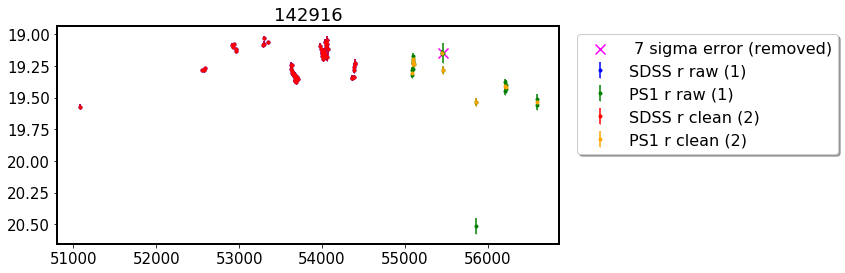

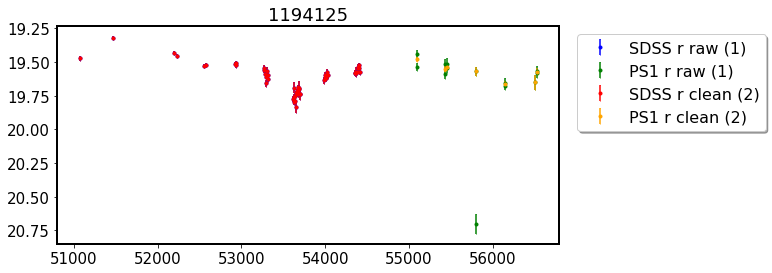

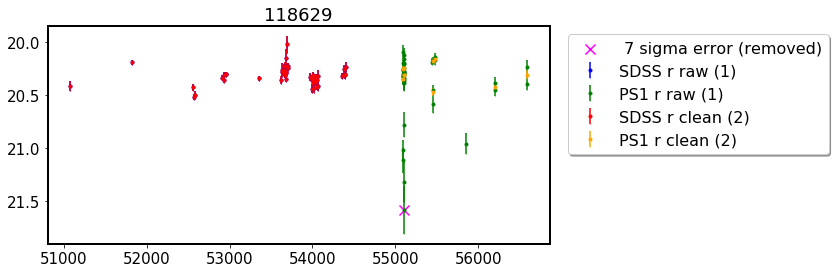

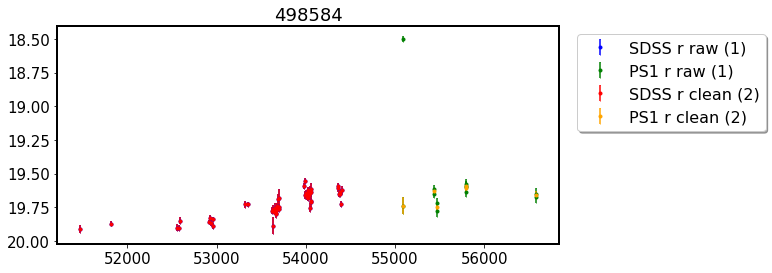

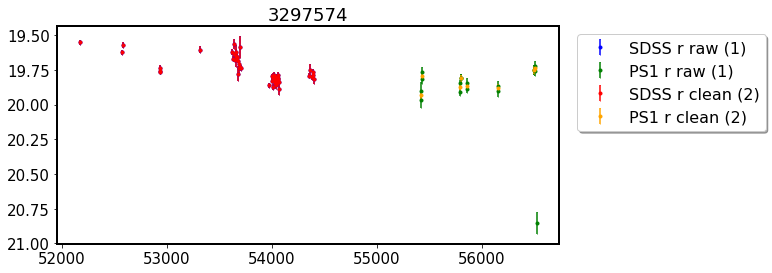

...

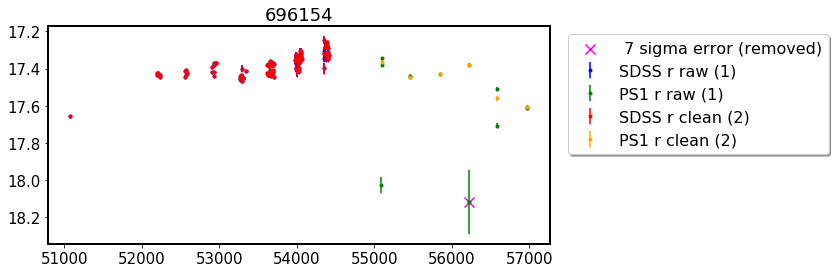

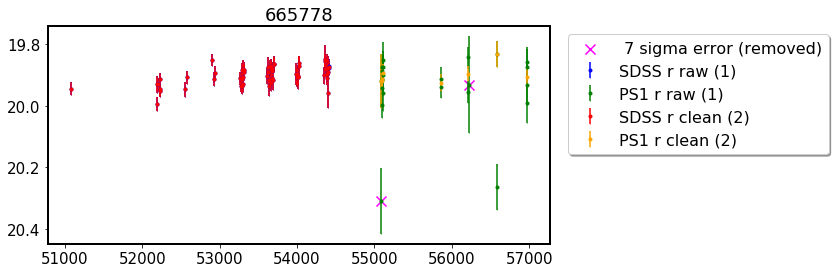

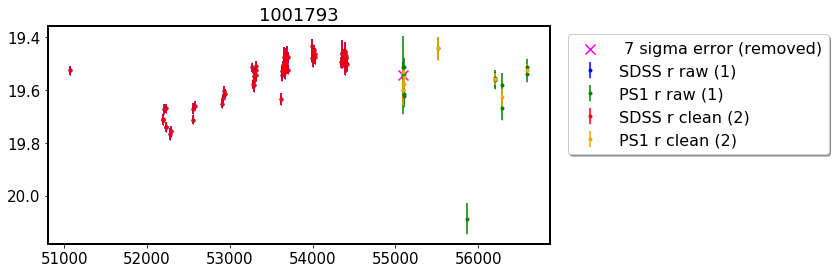

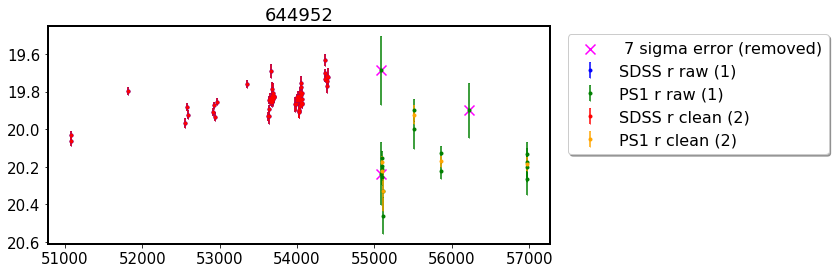

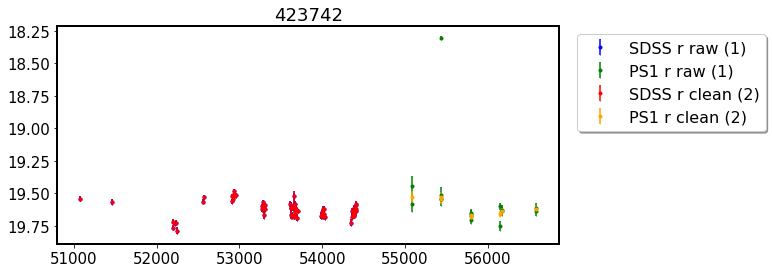

In [104]:
# Plot some light curves ... 
%matplotlib inline

for i in range(len(really_remove)):
    print(i)
    lcname = str(really_remove[i]) + '.txt'

    fig,ax = plt.subplots(1,1,figsize=(9,4))

    # plot the signal before cleaning (SDSS&PS1)
    lc = Table.read(rawDir+lcname, format='ascii')
    rows = lc['survey'] =='sdss'
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                        fmt=".", capsize=0.2, label='SDSS r raw (1)',
                        c ='blue', )
    rows = lc['survey'] == 'ps1'
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                    fmt=".", capsize=0.2, label='PS1 r raw (1)',
                    c ='green')
    
    # after cleaning:  
    lc = Table.read(finalDir+lcname, format='ascii')    

    # plot the clean SDSS
    rows = (lc['survey'] == 'sdss')
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                    fmt=".", capsize=0.2, label='SDSS r clean (2)',
                    c ='red')
    
    # plot the clean PS1 
    rows = lc['survey'] == 'ps1'
    ax.errorbar(lc['mjd'][rows], lc['mag'][rows], lc['magerr'][rows], 
                        fmt=".", capsize=0.2, label='PS1 r clean (2)',
                        c ='orange')
    
    ax.legend(fontsize=16,loc='upper left', bbox_to_anchor=(1.02,1),
            ncol=1, fancybox=True, shadow=True, )
    ax.invert_yaxis()
    ax.set_title(lcname[:-4])
    plt.savefig('SDSS_PS1_DR2_190807_cleaned_'+lcname[:-4]+'.png', 
               bbox_inches='tight')
    #plt.clf()
    #plt.clf()

Ok, now the light curves in `real_sdss_ps1r_dr2_cleaned_NEW` are ready to go ! 